# Capstone Project: Create a Customer Segmentation Report for Arvato Financial Services

In this project, you will analyze demographics data for customers of a mail-order sales company in Germany, comparing it against demographics information for the general population. You'll use unsupervised learning techniques to perform customer segmentation, identifying the parts of the population that best describe the core customer base of the company. Then, you'll apply what you've learned on a third dataset with demographics information for targets of a marketing campaign for the company, and use a model to predict which individuals are most likely to convert into becoming customers for the company. The data that you will use has been provided by our partners at Bertelsmann Arvato Analytics, and represents a real-life data science task.

If you completed the first term of this program, you will be familiar with the first part of this project, from the unsupervised learning project. The versions of those two datasets used in this project will include many more features and has not been pre-cleaned. You are also free to choose whatever approach you'd like to analyzing the data rather than follow pre-determined steps. In your work on this project, make sure that you carefully document your steps and decisions, since your main deliverable for this project will be a blog post reporting your findings.

In [1]:
# !pip install modin[dask]

In [31]:
# import libraries here; add more as necessary
import numpy as np
import pandas as pd
# import modin.pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

from sklearn.model_selection import train_test_split
from sklearn.metrics import plot_confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC, LinearSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB


from imblearn.over_sampling import SMOTENC
from imblearn.over_sampling import SMOTE

sns.set(style="ticks", color_codes=True)


# magic word for producing visualizations in notebook
%matplotlib inline

ModuleNotFoundError: No module named 'imblearn'

## Part 0: Get to Know the Data

There are four data files associated with this project:

- `Udacity_AZDIAS_052018.csv`: Demographics data for the general population of Germany; 891 211 persons (rows) x 366 features (columns).
- `Udacity_CUSTOMERS_052018.csv`: Demographics data for customers of a mail-order company; 191 652 persons (rows) x 369 features (columns).
- `Udacity_MAILOUT_052018_TRAIN.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 982 persons (rows) x 367 (columns).
- `Udacity_MAILOUT_052018_TEST.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 833 persons (rows) x 366 (columns).

Each row of the demographics files represents a single person, but also includes information outside of individuals, including information about their household, building, and neighborhood. Use the information from the first two files to figure out how customers ("CUSTOMERS") are similar to or differ from the general population at large ("AZDIAS"), then use your analysis to make predictions on the other two files ("MAILOUT"), predicting which recipients are most likely to become a customer for the mail-order company.

The "CUSTOMERS" file contains three extra columns ('CUSTOMER_GROUP', 'ONLINE_PURCHASE', and 'PRODUCT_GROUP'), which provide broad information about the customers depicted in the file. The original "MAILOUT" file included one additional column, "RESPONSE", which indicated whether or not each recipient became a customer of the company. For the "TRAIN" subset, this column has been retained, but in the "TEST" subset it has been removed; it is against that withheld column that your final predictions will be assessed in the Kaggle competition.

Otherwise, all of the remaining columns are the same between the three data files. For more information about the columns depicted in the files, you can refer to two Excel spreadsheets provided in the workspace. [One of them](./DIAS Information Levels - Attributes 2017.xlsx) is a top-level list of attributes and descriptions, organized by informational category. [The other](./DIAS Attributes - Values 2017.xlsx) is a detailed mapping of data values for each feature in alphabetical order.

In the below cell, we've provided some initial code to load in the first two datasets. Note for all of the `.csv` data files in this project that they're semicolon (`;`) delimited, so an additional argument in the [`read_csv()`](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.read_csv.html) call has been included to read in the data properly. Also, considering the size of the datasets, it may take some time for them to load completely.

You'll notice when the data is loaded in that a warning message will immediately pop up. Before you really start digging into the modeling and analysis, you're going to need to perform some cleaning. Take some time to browse the structure of the data and look over the informational spreadsheets to understand the data values. Make some decisions on which features to keep, which features to drop, and if any revisions need to be made on data formats. It'll be a good idea to create a function with pre-processing steps, since you'll need to clean all of the datasets before you work with them.

In [3]:
# load in the data
azdias = pd.read_csv('Udacity_AZDIAS_052018.csv', sep=';')
customers = pd.read_csv('Udacity_CUSTOMERS_052018.csv', sep=';')

/Users/nareshsharma/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (18,19) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

The following meanings are equivalent of NaN (by looking at DIAS Attributes - Values 2017.xlsx)- 
1. The value of -1, represents an unknown value
2. For a few other attrbutes a value of 0 or 9 or 10 is used to represent an unknow value... we'll takle this later


## Part 2: Supervised Learning Model

Now that you've found which parts of the population are more likely to be customers of the mail-order company, it's time to build a prediction model. Each of the rows in the "MAILOUT" data files represents an individual that was targeted for a mailout campaign. Ideally, we should be able to use the demographic information from each individual to decide whether or not it will be worth it to include that person in the campaign.

The "MAILOUT" data has been split into two approximately equal parts, each with almost 43 000 data rows. In this part, you can verify your model with the "TRAIN" partition, which includes a column, "RESPONSE", that states whether or not a person became a customer of the company following the campaign. In the next part, you'll need to create predictions on the "TEST" partition, where the "RESPONSE" column has been withheld.

In [5]:
mailout_train = pd.read_csv('Udacity_MAILOUT_052018_TRAIN.csv', sep=';')

In [6]:
print(mailout_train.shape)
print((mailout_train.RESPONSE.sum())*100/len(mailout_train))

(42962, 367)
1.2383036171500397


# Observations on data

1. The percentage of folks who actually become a customer is very less... hence we need a way to score with a higher recall

In [7]:
df_attrs = pd.read_excel('DIAS Attributes - Values 2017.xlsx', skiprows=1)
df_values = df_attrs.copy()
df_attrs.drop(columns=df_attrs.columns[0], inplace=True)
df_attrs.dropna(inplace=True)
df_attrs = df_attrs.reset_index()
print(df_attrs.shape)
df_attrs.head()

(314, 6)


,index,Attribute,Description,Value,Meaning,Type
0,0,AGER_TYP,best-ager typology,-1,unknown,Category
1,5,ALTERSKATEGORIE_GROB,age classification through prename analysis,"-1, 0",unknown,Numerical
2,11,ALTER_HH,main age within the household,0,unknown / no main age detectable,Numerical
3,33,ANREDE_KZ,gender,"-1, 0",unknown,Category
4,36,ANZ_HAUSHALTE_AKTIV,number of households in the building,…,numeric value (typically coded from 1-10),Numerical


In [8]:
df_values.drop(columns=df_values.columns[0], inplace=True)
df_values.Attribute = df_values.Attribute.fillna(method='ffill')
print(df_values.shape)
df_values.head()

(2258, 5)


,Attribute,Description,Value,Meaning,Type
0,AGER_TYP,best-ager typology,-1,unknown,Category
1,AGER_TYP,NaN,0,no classification possible,NaN
2,AGER_TYP,NaN,1,passive elderly,NaN
3,AGER_TYP,NaN,2,cultural elderly,NaN
4,AGER_TYP,NaN,3,experience-driven elderly,NaN


In [9]:
common_columns = (set(list(df_attrs.Attribute)) & set(list(mailout_train.columns)))
common_columns

{'AGER_TYP',
 'ALTERSKATEGORIE_GROB',
 'ALTER_HH',
 'ANREDE_KZ',
 'ANZ_HAUSHALTE_AKTIV',
 'ANZ_HH_TITEL',
 'ANZ_PERSONEN',
 'ANZ_TITEL',
 'BALLRAUM',
 'CAMEO_DEUG_2015',
 'CAMEO_DEU_2015',
 'CJT_GESAMTTYP',
 'D19_BANKEN_ANZ_12',
 'D19_BANKEN_ANZ_24',
 'D19_BANKEN_DATUM',
 'D19_BANKEN_OFFLINE_DATUM',
 'D19_BANKEN_ONLINE_DATUM',
 'D19_BANKEN_ONLINE_QUOTE_12',
 'D19_GESAMT_ANZ_12',
 'D19_GESAMT_ANZ_24',
 'D19_GESAMT_DATUM',
 'D19_GESAMT_OFFLINE_DATUM',
 'D19_GESAMT_ONLINE_DATUM',
 'D19_GESAMT_ONLINE_QUOTE_12',
 'D19_KONSUMTYP',
 'D19_TELKO_ANZ_12',
 'D19_TELKO_ANZ_24',
 'D19_TELKO_DATUM',
 'D19_TELKO_OFFLINE_DATUM',
 'D19_TELKO_ONLINE_DATUM',
 'D19_VERSAND_ANZ_12',
 'D19_VERSAND_ANZ_24',
 'D19_VERSAND_DATUM',
 'D19_VERSAND_OFFLINE_DATUM',
 'D19_VERSAND_ONLINE_DATUM',
 'D19_VERSAND_ONLINE_QUOTE_12',
 'D19_VERSI_ANZ_12',
 'D19_VERSI_ANZ_24',
 'EWDICHTE',
 'FINANZTYP',
 'FINANZ_ANLEGER',
 'FINANZ_HAUSBAUER',
 'FINANZ_MINIMALIST',
 'FINANZ_SPARER',
 'FINANZ_UNAUFFAELLIGER',
 'FINANZ_VORSORGER

In [10]:
def mark_invalid_values_as_null(df):
    categorical_dict = {}
    df_categorical = pd.DataFrame()
#     dataTypeDict = dict(df.dtypes)
    for colname in common_columns:
#         print('{} - {}'.format(colname, df_attrs[df_attrs.Attribute==colname].Type.values[0]))
        valid_values = df_values[(df_values.Attribute==colname) & \
                                 ((df_values.Meaning.str.contains('unknown')==False) \
                                 | df_values.Meaning.isnull())].Value.values
        if ('X' in df[colname].unique()) or ('XX' in df[colname].unique()):
            print('unique values for column:{}, are {}'.format(colname, df[colname].unique()))
        if (df_attrs[df_attrs.Attribute==colname].Value.values[0] == '…'):
            print('{} is a continuous feature'.format(colname))
        else:
#             print('valid values for column:{}, are {}'.format(colname, valid_values))
            
            m = df[colname].isin(valid_values)
            df[colname] = df[colname].where(m, other=np.nan)
            print(sum(m))
#         if df_attrs[df_attrs.Attribute==colname].Type.values[0] == 'Category': 
# #           converting from int to float rather than from float to int, as type conversion with NaNs
# #           doesn't work when converting to ints
#             print('Category data type={}'.format(df.dtypes[colname]))
#             if df.dtypes[colname]=='float64':
#                 df[colname] = df[colname].astype(pd.Int16Dtype())
                
#             # make this column as categorical, so that get_dummies works consistently
#             print('unqiue cat values in the DF are: {}'.format(df[colname].unique()))
#             categorical_dict[colname] = pd.Categorical(valid_values)
#             df[colname] = pd.Categorical(df[colname], categories = valid_values)
    return df, categorical_dict

In [11]:
mailout_train1, _ = mark_invalid_values_as_null(mailout_train[common_columns])
# column:CAMEO_DEUG_2015

34314
35000
42962


/Users/nareshsharma/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:10: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  # Remove the CWD from sys.path while we load stuff.
/Users/nareshsharma/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


35000
42962
35000
35000
33931
35000
32545
35000
42357
33931
42962
35000
33931
35000
35000
34809
35000
35000
42962
42962
KBA13_ANZAHL_PKW is a continuous feature
42962
35000
35185
34809
35000
35000
35000
33931
35000
33931
34809
34314
34708
35000
33931
35000
35000
35508
35000
35000
35000
35000
33931
42962
35000
35000
35565
33931
35000
35378
33931
35378
42962
35000
35000
35000
42962
unique values for column:CAMEO_DEUG_2015, are [5.0 2.0 7.0 4.0 nan 3.0 6.0 1.0 8.0 9.0 '4' '6' '2' '9' '8' '7' '3' '1'
 '5' 'X']
25047
33931
ANZ_PERSONEN is a continuous feature
35000
35565
35000
35000
35000
33931
42258
35000
35000
35007
33931
35000
35000
34809
33931
33931
42962
33032
42962
35000
42962
42962
24999
42962
33931
34149
35000
42962
35000
35000
35000
35000
34809
42962
33931
42357
33953
34314
33931
33931
35000
33931
34059
33931
33931
35000
35000
42962
GEBURTSJAHR is a continuous feature
42357
42962
42962
35004
34149
35000
35000
42962
42962
29785
33931
33032
35000
42962
35185
33931
42962
42962
33931
3

In [12]:
def plot_hist_missing_col(df):
    '''
    INPUT:
        df - (dataframe), dataframe to check for missing data and plot histogram of the missing data in columns
    OUTPUT:
        visualization: (histogram), of the missing data
    '''
    plt.hist(df['pct'], bins=20, facecolor='g', alpha=0.75)

    plt.xlabel('Pe\rcentage of missing value (%)', fontsize=12)
    plt.ylabel('Counts', fontsize=12)
    plt.title('Histogram of missing value counts in columns', fontsize=12)
    plt.grid(True)
    plt.show()


def get_null_counts(df):
    null_data = df.isnull().sum()[df.isnull().sum() > 0]
    dict = {'nulls': null_data.values, 'pct': np.round(null_data.values*100/df.shape[0], 2)}
    df_nulls = pd.DataFrame(data=dict, index=null_data.index)
    return df_nulls

/Users/nareshsharma/anaconda3/lib/python3.6/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 13 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/nareshsharma/anaconda3/lib/python3.6/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 13 missing from current font.
  font.set_text(s, 0, flags=flags)


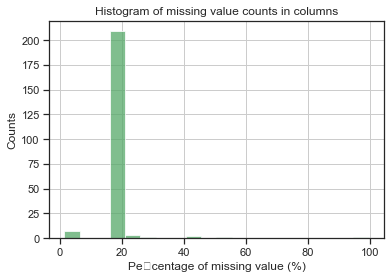

                 nulls    pct
W_KEIT_KIND_HH   10417  24.25
CAMEO_DEUG_2015  17915  41.70
AGER_TYP         17963  41.81
ALTER_HH         13177  30.67
TITEL_KZ         42749  99.50
KBA05_BAUMAX     22980  53.49


In [13]:
mailout_nulls = get_null_counts(mailout_train1)
plot_hist_missing_col(mailout_nulls)
# mailout_nulls.sort_values(by=['pct'], axis=0, kind='quicksort', ascending=False)
# mailout_nulls
print(mailout_nulls[mailout_nulls.pct > 24])

In [14]:
# Observations
# The columns that have a large number of nulls pretty much match the columns of general population, having large number of nulls
# Also all the columns that were used for clustering are available in the mailout dataset... so we should be able to apply the same cleanup process to this dataset
mailout_train1 = mailout_train1.drop(columns=mailout_nulls[mailout_nulls.pct>24].index)
final_column_list = mailout_train1.columns


In [15]:
# First separate the datset into responses and their equivalent features
df_response = mailout_train.RESPONSE
# df_features = mailout_train.drop(columns=['RESPONSE'])

In [134]:
# need to label encode a few alphanumeric columns before feature engineering
# CAMEO_DEU_2015, OST_WEST_KZ
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
# fitted = le.fit_transform(mailout_train1[['OST_WEST_KZ']])

fit_by = pd.Series([i for i in mailout_train1['OST_WEST_KZ'].unique() if type(i) == str])
le.fit(fit_by)
mailout_train1["OST_WEST_KZ"] = fit_by.apply(lambda x: le.transform([x])[0] if type(x) == str else x)

In [135]:
mailout_train1['OST_WEST_KZ'].unique()

array([ 1.,  0., nan])

In [136]:
mailout_train1['CAMEO_DEU_2015'].unique()

array(['5D', '5B', '2D', '7B', '4C', '5C', nan, '3D', '5A', '2C', '4A',
       '6B', '1A', '8D', '4B', '7A', '4E', '3A', '7C', '9D', '8A', '5E',
       '8B', '3C', '6E', '4D', '2B', '3B', '7E', '2A', '6C', '1C', '6D',
       '7D', '1D', '8C', '9A', '9B', '9C', '9E', '6F', '1E', '6A', '5F',
       '1B'], dtype=object)

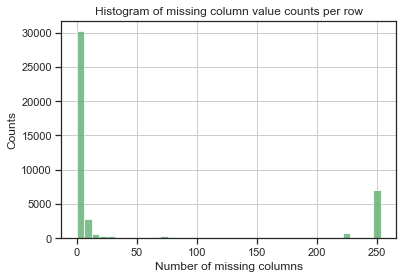

In [17]:
null_row_counts = mailout_train.isnull().sum(axis=1)
null_row_counts.values

plt.hist(null_row_counts.values, bins=40, facecolor='g', alpha=0.75)

plt.xlabel('Number of missing columns', fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title('Histogram of missing column value counts per row', fontsize=12)
plt.grid(True)
plt.show()

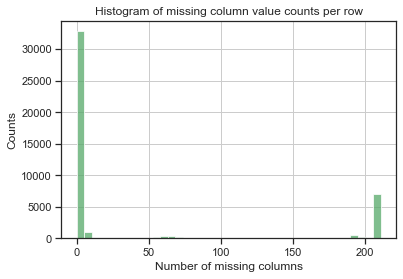

In [16]:
null_row_counts = mailout_train1.isnull().sum(axis=1)
null_row_counts.values

plt.hist(null_row_counts.values, bins=40, facecolor='g', alpha=0.75)

plt.xlabel('Number of missing columns', fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title('Histogram of missing column value counts per row', fontsize=12)
plt.grid(True)
plt.show()

In [18]:
# most of the rows conatin at least 1 or 2 null values.
# let's drop all rows that conatin more than 20 columns with null values
mailout_train1['RESPONSE'] = mailout_train.RESPONSE
mailout_train1 = mailout_train1.dropna(thresh=len(mailout_train1.columns)-40)
mailout_train1.reset_index(drop=True)
df_response = mailout_train1[['RESPONSE']]
mailout_train1 = mailout_train1.drop(columns='RESPONSE')


In [19]:
print(mailout_train1.shape)
print(df_response.shape)

(33837, 266)
(33837, 1)


In [20]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(missing_values= np.nan, strategy='most_frequent')

In [21]:
imputed_data = imputer.fit_transform(mailout_train1)
mailout_train1 = pd.DataFrame(imputed_data, columns = mailout_train1.columns)


In [22]:
mailout_train1.shape

(33837, 266)

In [23]:
# tmp drop the CAMEO_DEU_2015 column
mailout_train1 = mailout_train1.drop(columns=['CAMEO_DEU_2015','OST_WEST_KZ'])

In [24]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

# data = pd.read_csv("D://Blogs//train.csv")

X = mailout_train1 #.drop(columns=['RESPONSE'])  #independent columns
y = df_response    #target column i.e price range
#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=200)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
#concat two dataframes for better visualization 
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(200,'Score'))  #print 10 best features

                           Specs       Score
22              KBA13_ANZAHL_PKW  697.092930
109                  GEBURTSJAHR  334.911476
237                D19_KONSUMTYP  106.256508
148          ANZ_HAUSHALTE_AKTIV   48.142562
40         PRAEGENDE_JUGENDJAHRE   24.238472
135          LP_LEBENSPHASE_GROB   22.497381
255                   KBA05_CCM4   14.866698
180  D19_VERSAND_ONLINE_QUOTE_12   12.603137
86               LP_FAMILIE_GROB   12.139173
81                KBA13_CCM_3000   10.469374
85                     KBA05_KW3   10.049075
52    D19_GESAMT_ONLINE_QUOTE_12    9.602759
251               KBA13_CCM_2501    9.160690
174                   KBA05_ZUL4    8.454286
184                   KBA05_SEG6    7.729069
170         KBA13_SEG_WOHNMOBILE    7.705608
132                    ANZ_TITEL    6.818343
209                FINANZ_SPARER    6.410722
102                   KBA05_MOD1    6.400315
88             D19_GESAMT_ANZ_12    6.291038
68            HH_EINKOMMEN_SCORE    5.639346
257       

In [25]:
# Let's do a PCA with what seems to be a valid set of data now
# use PCA for analysis and dimensionality reduction
from sklearn.decomposition import PCA

# let's create a reusable function to execute PCA on data to a stated n number of components
# because we'll need to experiment with different number of PCA components
def do_pca(data, n):
    pca = PCA(n_components=n, random_state=1)
    X_pca = pca.fit_transform(data)
    return pca, X_pca



In [26]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
mailout_scaled = scaler.fit_transform(mailout_train1)
mailout_scaled = pd.DataFrame(mailout_scaled, columns= list(mailout_train1.columns.values))

In [27]:
# let's scale all the features before we apply PCA


pca, X_pca = do_pca(mailout_scaled, 130)

In [28]:
def plot_variance(pca):
    num_components=len(pca.explained_variance_ratio_)
    num_components = np.arange(num_components)
    ratios = pca.explained_variance_ratio_
 
    plt.figure(figsize=(10, 10))
    ax = plt.subplot(111)
    cumvals = np.cumsum(ratios)
    ax.bar(num_components, ratios)
    ax.plot(num_components, cumvals)
    
    ax.grid()
    ax.set_axisbelow(True)
    ax.grid(linewidth='0.5', alpha=0.5)
   
 
    ax.xaxis.set_tick_params(width=0)
    ax.yaxis.set_tick_params(width=2, length=12)
 
    ax.set_xlabel("Principal Component")
    ax.set_ylabel("Variance Explained (%)")
    plt.title('Explained Variance Per Principal Component')

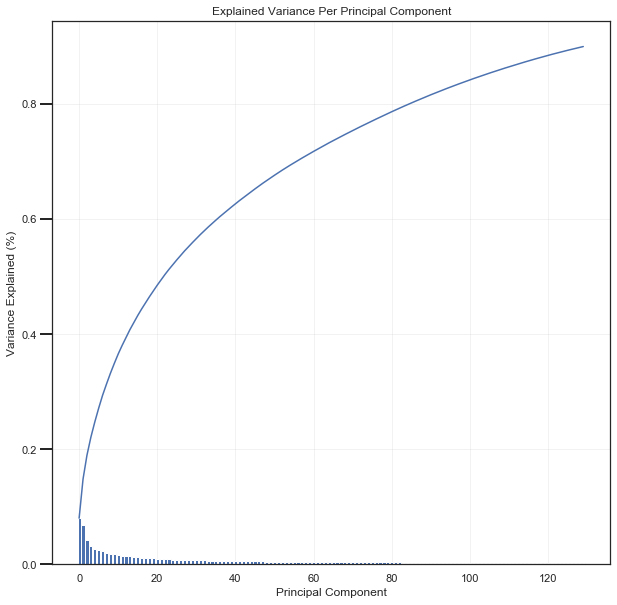

In [29]:
plot_variance(pca)
# this is not the right thing to do though... as I have not yet converted the dummy variables into separate features

In [30]:
# let's give a first cut try to train a random forest with class_weight set to balanced
df_response.sum() 
# we have lost more than 100 positive ressponses... that seems too much, but can't be helped


RESPONSE    416
dtype: int64

In [37]:
import time
def show_confusion_matrix(classifier, X_test, y_test):
    class_names=['NO', 'YES']
    # Plot non-normalized confusion matrix
    titles_options = [("Confusion matrix, without normalization", None),
                      ("Normalized confusion matrix", 'true')]
    for title, normalize in titles_options:
        disp = plot_confusion_matrix(classifier, X_test, y_test,
                                     display_labels=class_names,
                                     cmap=plt.cm.Blues,
                                     normalize=normalize)
        disp.ax_.set_title(title)

        print(title)
        print(disp.confusion_matrix)

    plt.show()

def fit_classifier(clf, param_grid, X_train, Y_train, X_test, Y_test):
    """
    Fits a classifier to its training data using GridSearchCV and calculates ROC AUC score
    
    INPUT:
    - clf (classifier): classifier to fit
    - param_grid (dict): classifier parameters used with GridSearchCV
    - X_train (DataFrame): training input
    - y_train (DataFrame): training output
            
    OUTPUT:
    - classifier: input classifier fitted to the training data
    """
    
    # cv uses StratifiedKFold
    # scoring roc_auc available as parameter
    start = time.time()
    grid = GridSearchCV(estimator=clf, param_grid=param_grid, scoring='roc_auc', cv=5, verbose=0, n_jobs=6)
    print("Training {} :".format(clf.__class__.__name__))
    grid.fit(X_train, Y_train)
    end = time.time()
    time_taken = round(end-start,2)

    print(clf.__class__.__name__)
    print("Time taken : {} secs".format(time_taken))
    print("Best score : {}".format(round(grid.best_score_,4)))
    print("*"*40)
    
    show_confusion_matrix(grid.best_estimator_, X_test, Y_test)
    
    print('--------------------------------')
    
    return grid.best_score_, grid.best_estimator_, time_taken

In [85]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
X = mailout_train1  #independent columns
y = df_response    #target column i.e price range
#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=200)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
#concat two dataframes for better visualization 
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(200,'Score'))  #print 10 best features

ValueError: Input X must be non-negative.

In [67]:
X = mailout_train1  #independent columns
y = df_response    #target column i.e price range
from sklearn.ensemble import ExtraTreesClassifier
import matplotlib.pyplot as plt
model = ExtraTreesClassifier()
model.fit(X,y)
# print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers
#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)

/Users/nareshsharma/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


In [66]:
feat_importances.sort_values(ascending=False)
# feat_importances.sort_values(by='')

# feat_importances.nlargest(20).plot(kind='barh')
# plt.show()

KBA05_HERST3                   0.005349
KBA13_BJ_2008                  0.005005
KBA13_FIAT                     0.004982
KBA05_ALTER4                   0.004960
KBA05_SEG2                     0.004958
KBA13_VW                       0.004944
KBA13_ANZAHL_PKW               0.004881
KBA05_MODTEMP                  0.004825
MIN_GEBAEUDEJAHR               0.004785
KBA13_SEG_MINIWAGEN            0.004777
KBA05_SEG4                     0.004749
KBA05_MOTRAD                   0.004728
KBA13_FORD                     0.004721
KBA13_CCM_2500                 0.004669
KBA05_KW2                      0.004663
KBA05_ALTER2                   0.004656
KONSUMNAEHE                    0.004601
D19_VERSAND_OFFLINE_DATUM      0.004580
KBA13_ALTERHALTER_45           0.004573
SEMIO_MAT                      0.004570
KBA05_SEG3                     0.004564
KBA05_KRSHERST3                0.004558
KBA13_SEG_OBERKLASSE           0.004551
KBA05_MOD2                     0.004481
KBA13_HALTER_60                0.004470


In [83]:
# Let's look at the coorelation matrix
# X = mailout_train  #independent columns
# y = df_response    #target column i.e price range
#get correlations of each features in dataset

#### list_new_new_w.astype(float).corr()

corrmat = mailout_train1.astype(float).corr()
# corrmat.head()
top_corr_features = corrmat.index


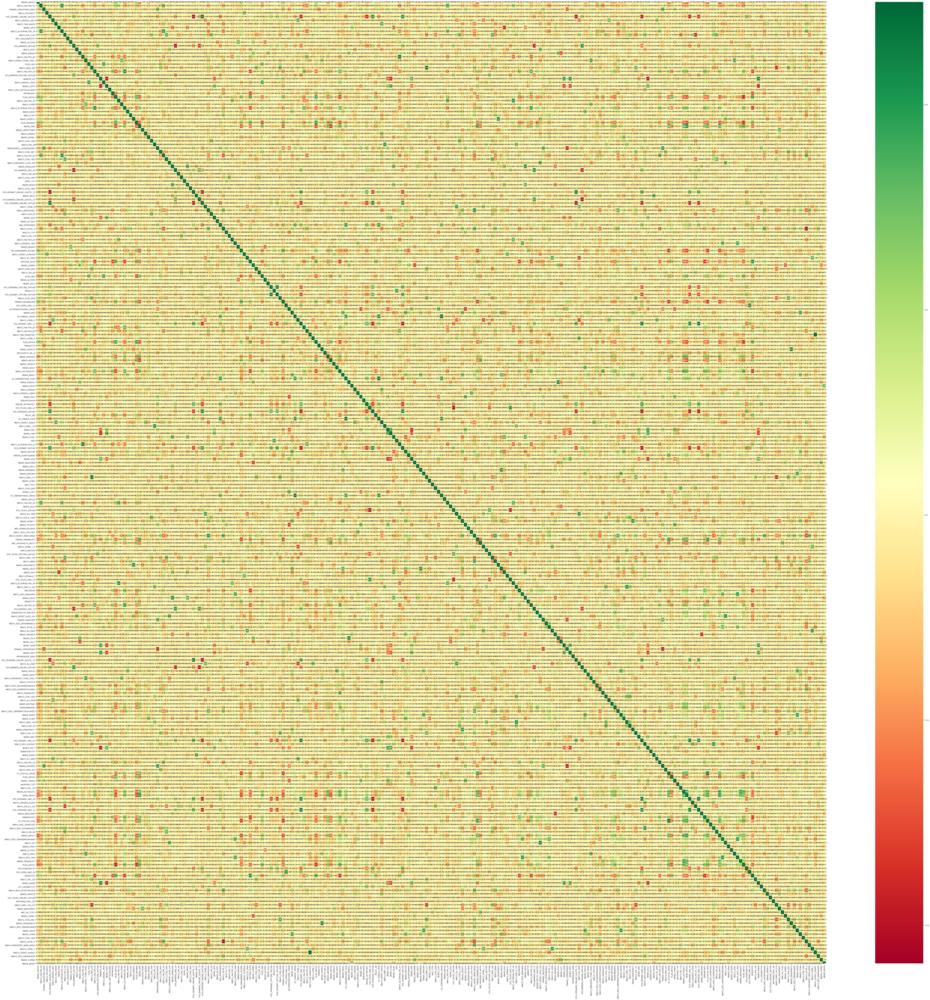

In [86]:
plt.figure(figsize=(100,100))
#plot heat map
g=sns.heatmap(mailout_train1[top_corr_features].astype(float).corr(),annot=True,cmap="RdYlGn")

In [38]:
X_train, X_test, y_train, y_test = train_test_split(mailout_train1.astype(float), \
                                                    df_response, \
                                                    test_size=0.33, random_state=40)

In [46]:
y_train.sum()

RESPONSE    284
dtype: int64

Training RandomForestClassifier :


/Users/nareshsharma/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_search.py:739: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.best_estimator_.fit(X, y, **fit_params)


RandomForestClassifier
Time taken : 50.89 secs
Best score : 0.5921
****************************************
Confusion matrix, without normalization
[[11035     0]
 [  132     0]]
Normalized confusion matrix
[[1. 0.]
 [1. 0.]]


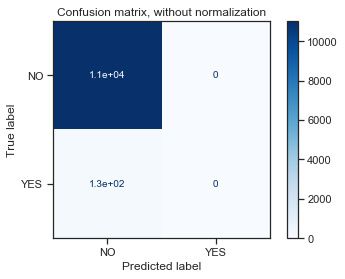

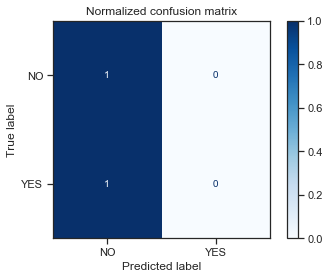

--------------------------------


(0.5921374907456249,
 RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                        criterion='gini', max_depth=None, max_features='auto',
                        max_leaf_nodes=None, max_samples=None,
                        min_impurity_decrease=0.0, min_impurity_split=None,
                        min_samples_leaf=1, min_samples_split=2,
                        min_weight_fraction_leaf=0.0, n_estimators=300,
                        n_jobs=None, oob_score=False, random_state=None,
                        verbose=0, warm_start=False),
 50.89)

In [39]:
# let's get a quick feel of predictability
grid_params = {
    'class_weight': ['balanced'],
    'n_estimators': [100,200,300]
}

fit_classifier(RandomForestClassifier(), grid_params, X_train, y_train, X_test, y_test)

In [58]:
mailout_train2 = mailout_train1[featureScores[featureScores.Score > 1].Specs.values]
mailout_train2.shape

(33837, 102)

## Part 3: Kaggle Competition

Now that you've created a model to predict which individuals are most likely to respond to a mailout campaign, it's time to test that model in competition through Kaggle. If you click on the link [here](http://www.kaggle.com/t/21e6d45d4c574c7fa2d868f0e8c83140), you'll be taken to the competition page where, if you have a Kaggle account, you can enter. If you're one of the top performers, you may have the chance to be contacted by a hiring manager from Arvato or Bertelsmann for an interview!

Your entry to the competition should be a CSV file with two columns. The first column should be a copy of "LNR", which acts as an ID number for each individual in the "TEST" partition. The second column, "RESPONSE", should be some measure of how likely each individual became a customer – this might not be a straightforward probability. As you should have found in Part 2, there is a large output class imbalance, where most individuals did not respond to the mailout. Thus, predicting individual classes and using accuracy does not seem to be an appropriate performance evaluation method. Instead, the competition will be using AUC to evaluate performance. The exact values of the "RESPONSE" column do not matter as much: only that the higher values try to capture as many of the actual customers as possible, early in the ROC curve sweep.

In [ ]:
# mailout_test = pd.read_csv('../../data/Term2/capstone/arvato_data/Udacity_MAILOUT_052018_TEST.csv', sep=';')